In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import scirpy as ir

In [2]:
import sys
sys.path.append('../..')
import tcr_embedding.utils_training as utils
import config.constants_10x as const

from tcr_embedding.utils_preprocessing import stratified_group_shuffle_split, group_shuffle_split
from tcr_embedding.evaluation.Imputation import run_imputation_evaluation
from tcr_embedding.evaluation.Clustering import run_clustering_evaluation
from tcr_embedding.evaluation.kNN import run_knn_within_set_evaluation
from tcr_embedding.evaluation.WrapperFunctions import get_model_prediction_function

In [3]:
import matplotlib.pyplot as plt
from matplotlib import rcParams
rcParams['figure.figsize'] = (12, 12)

In [5]:
def load_data():
    random_seed = 42
    utils.fix_seeds(random_seed)
    adata = utils.load_data('borcherding')

    # Randomly select patients to be left out during training
    def get_n_patients(amount_patients):
        if amount_patients <= 5:
            return 0
        else:
            return 2

    holdout_patients = []

    adata.obs['Tissue+Type'] = [f'{tissue}.{type_}' for tissue, type_ in zip(adata.obs['Tissue'], adata.obs['Type'])]
    counts = adata.obs.groupby('Tissue+Type')['Sample'].value_counts()
    for cat in adata.obs['Tissue+Type'].unique():
        n = get_n_patients(len(counts[cat]))
        choice = np.random.choice(counts[cat].index, n, replace=False).tolist()
        holdout_patients += choice

    adata.obs['set'] = ['hold_out' if row in holdout_patients else 'train' for row in adata.obs['Sample']]
    return adata
adata_borch = load_data()
adata_borch.obs['set'].value_counts()

train       467965
hold_out    254496
Name: set, dtype: int64

In [6]:
def load_model(adata, weight, name='moe'):
    path_model = f'saved_models/journal/Borcherding/borcherding_{name}_{weight}.pt'
    model = utils.load_model(adata, path_model)
    return model

In [7]:
metadata = ['Tissue', 'Type', 'Tissue+Type', 'Sample', 'functional.cluster', 'clonotype', 'set']

In [7]:
sc.pp.neighbors(adata_borch)
sc.tl.umap(adata_borch)

... storing 'Tissue+Type' as categorical
... storing 'set' as categorical


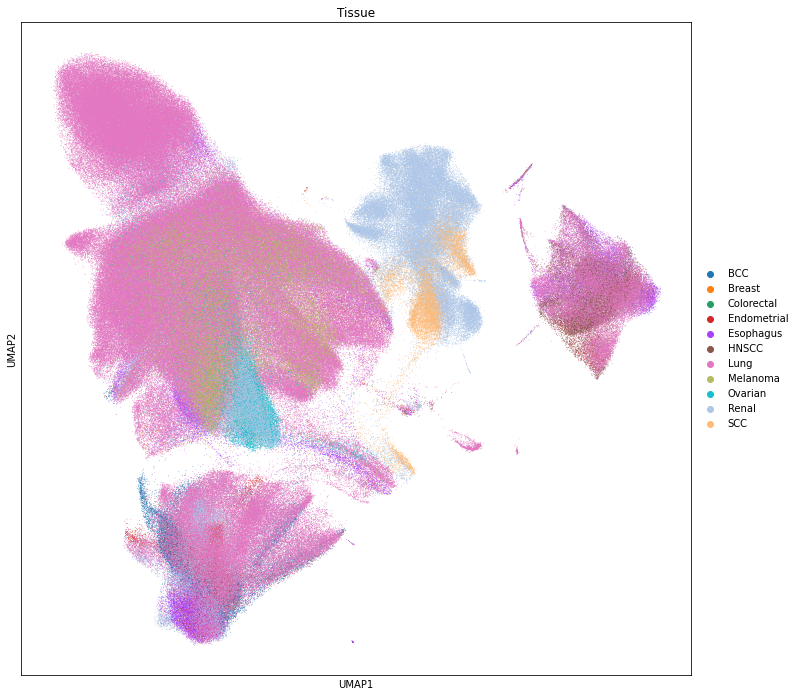

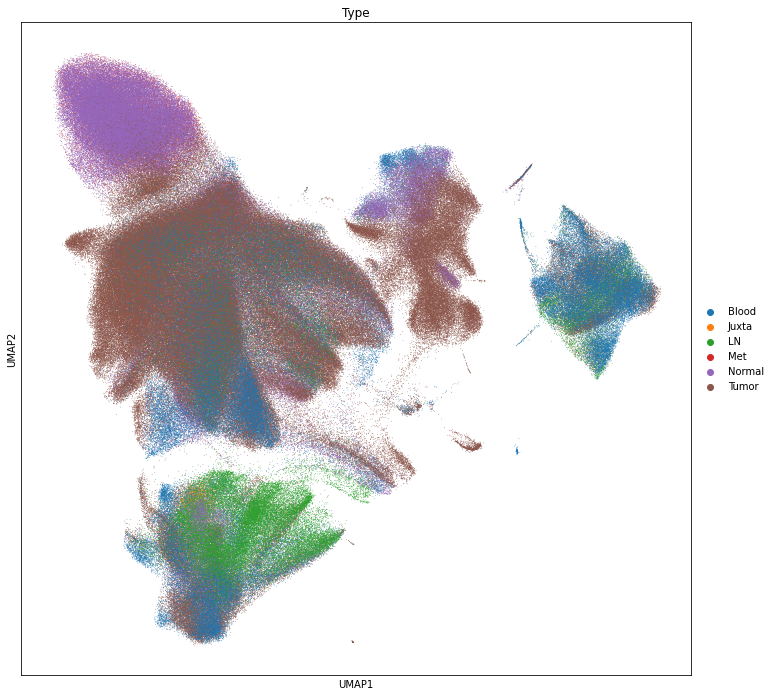

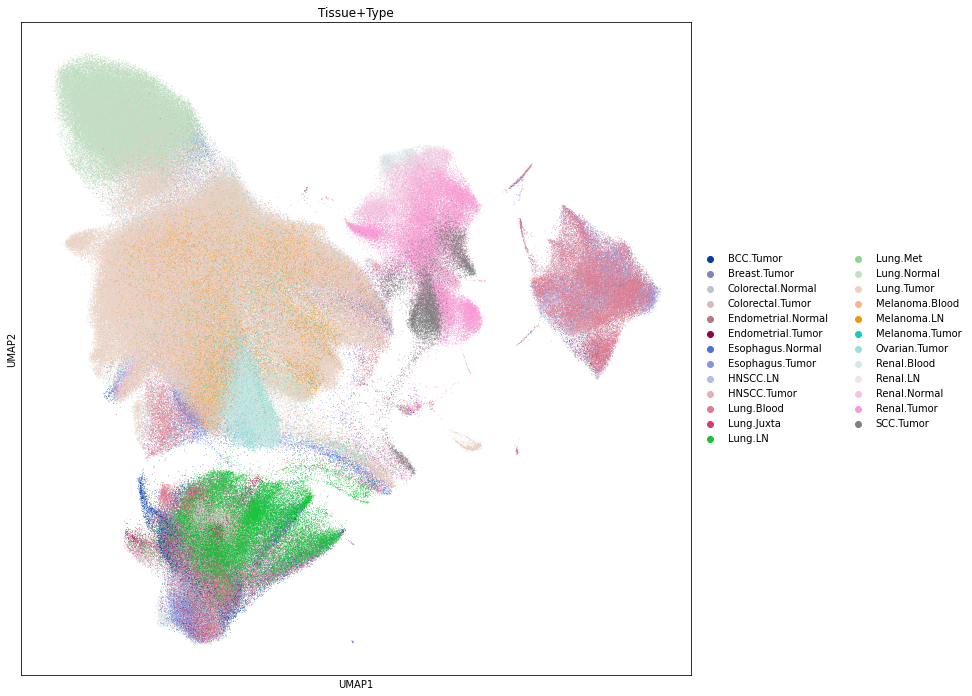

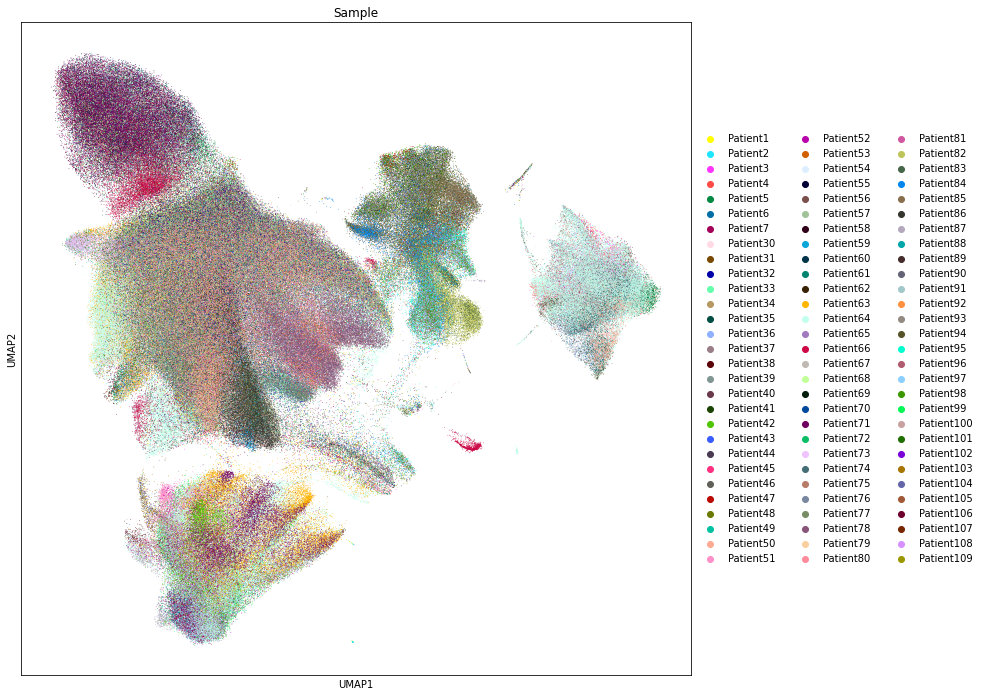

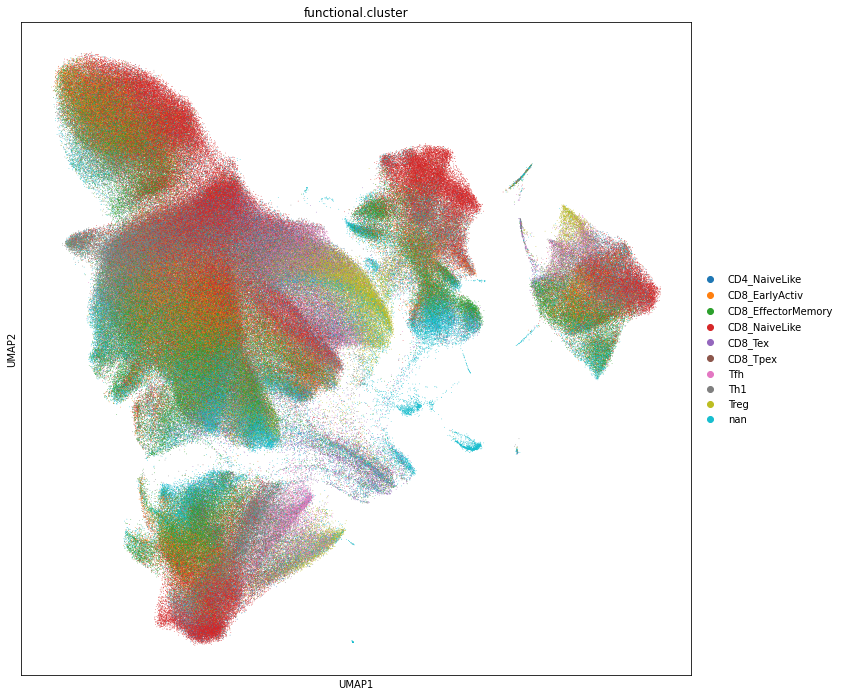

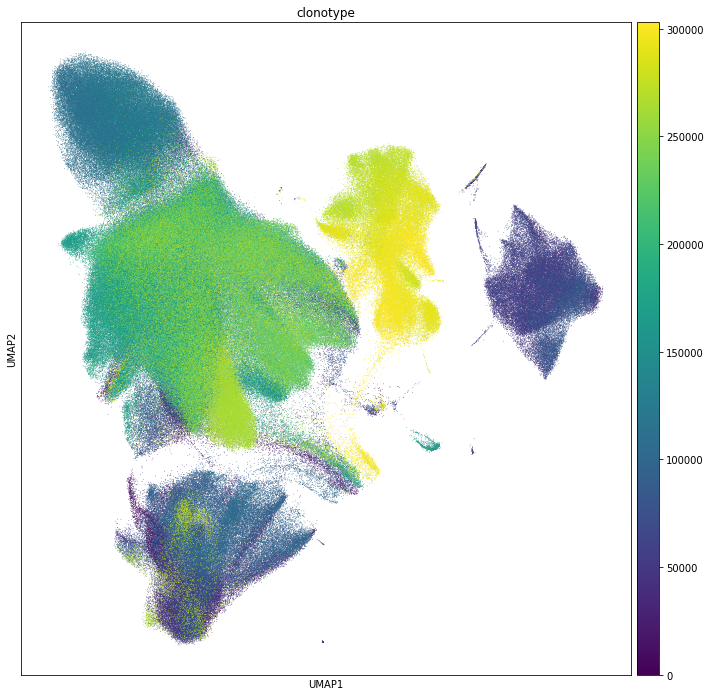

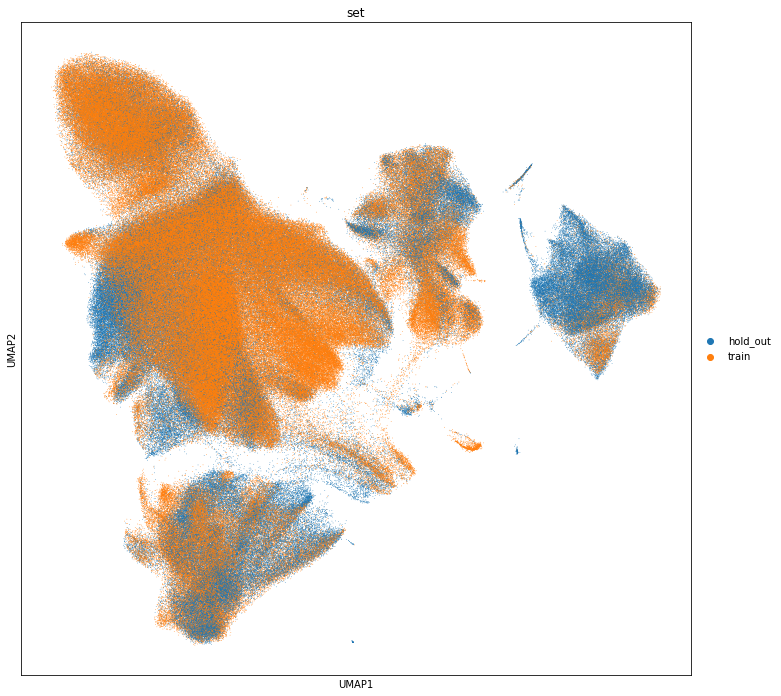

In [8]:
for col in metadata:
    sc.pl.umap(adata_borch, color=col, size=2)

In [9]:
model_moe = load_model(adata_borch, 10)
latent_moe = model_moe.get_latent(adata_borch, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_moe)

In [10]:
sc.tl.umap(latent_moe, min_dist=1)

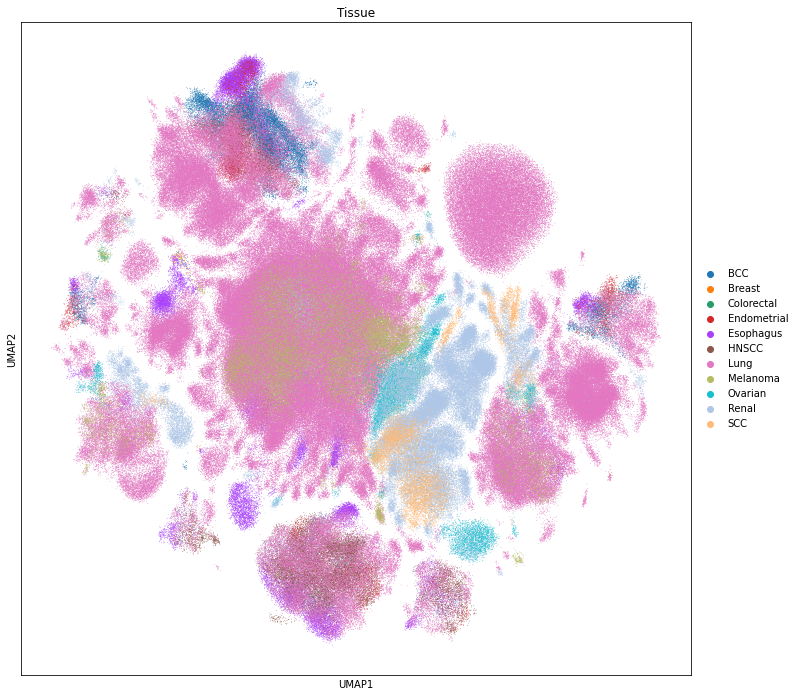

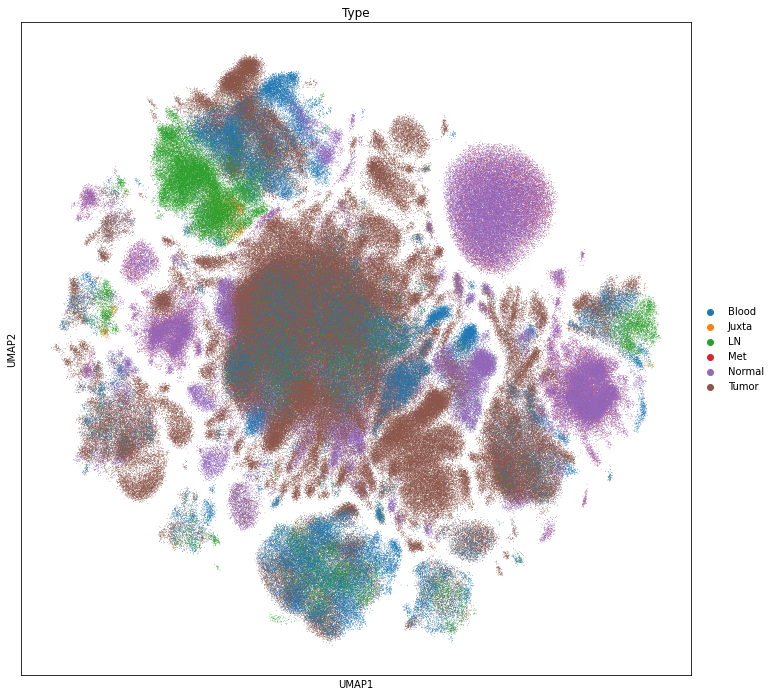

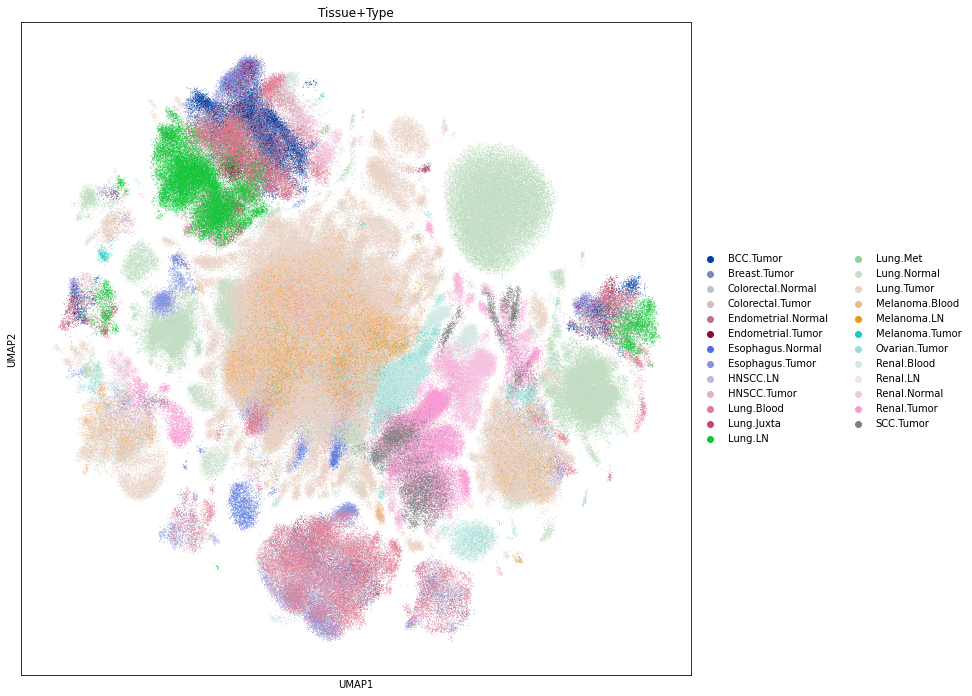

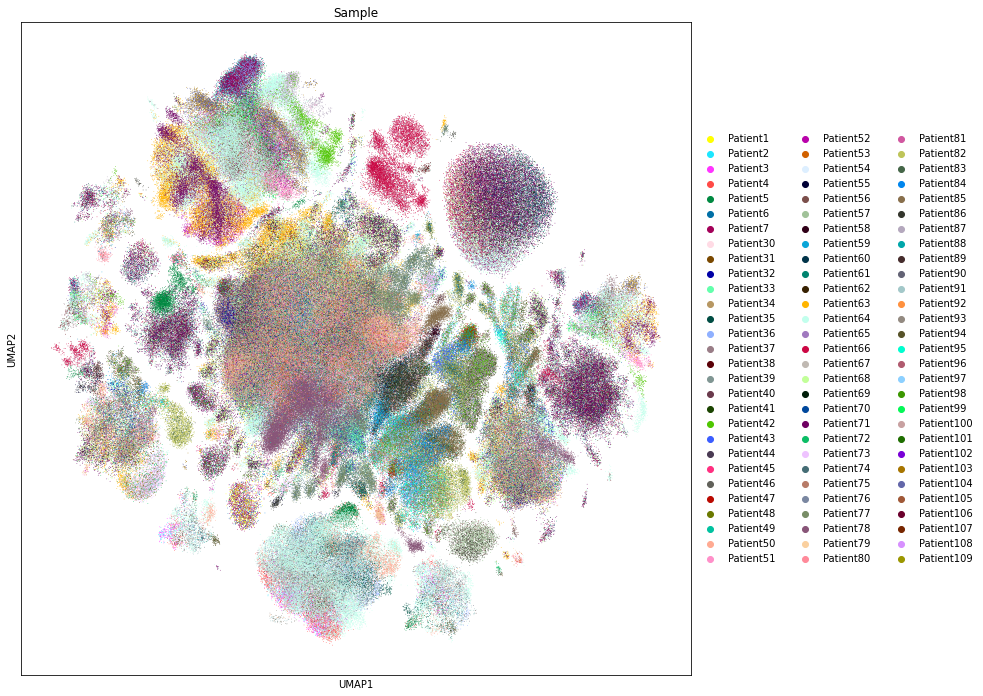

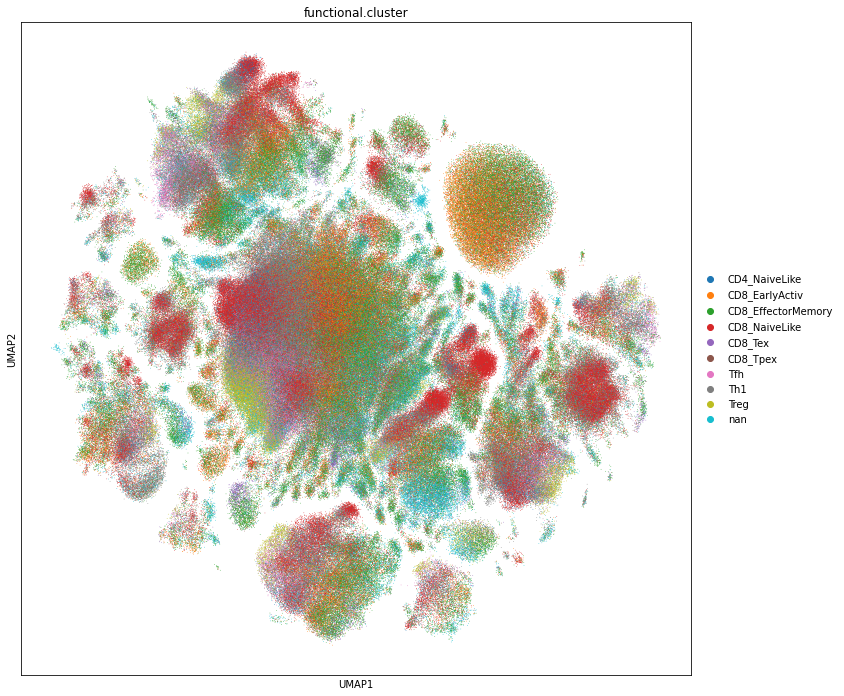

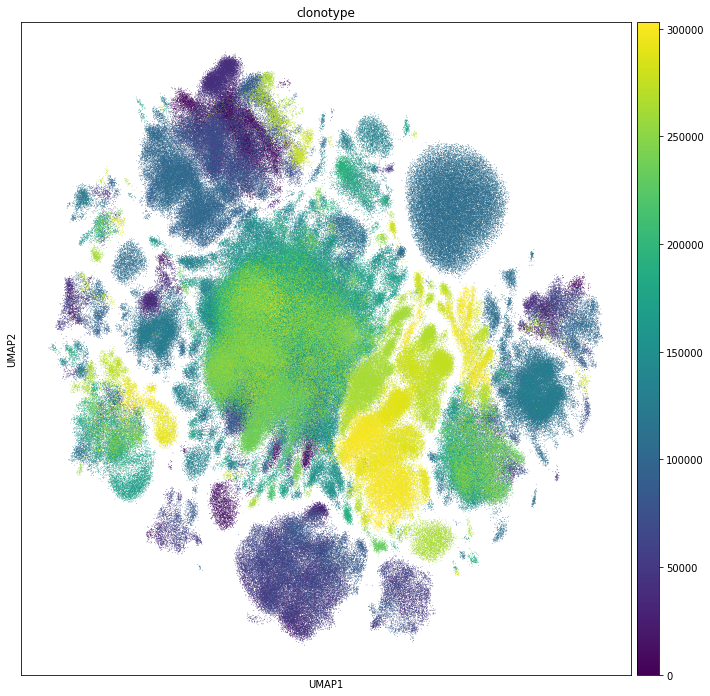

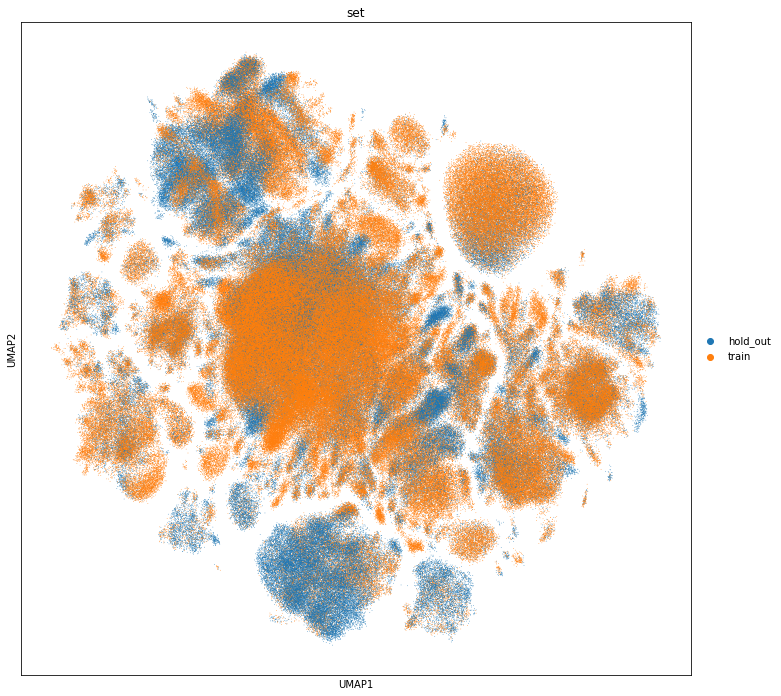

In [11]:
for col in metadata:
    sc.pl.umap(latent_moe, color=col, size=2)

In [19]:
adata_borch.obs.columns.tolist()

['orig.ident',
 'nCount_RNA',
 'nFeature_RNA',
 'mito.genes',
 'db.weight.score',
 'db.ratio',
 'db.class',
 'db.score',
 'HPCA.first.labels',
 'HPCA.labels',
 'HPCA.pruned.labels',
 'DICE.first.labels',
 'DICE.labels',
 'DICE.pruned.labels',
 'functional.cluster',
 'functional.cluster.conf',
 'consensus.major',
 'consensus.Tcell',
 'barcode',
 'CTgene_x',
 'CTnt_x',
 'CTaa_x',
 'CTstrict_x',
 'Frequency',
 'cloneType',
 'Treg_UCell',
 'CD8_Activation_UCell',
 'Antinflammatory_UCell',
 'Anergy_UCell',
 'Proinflammatory_UCell',
 'Lipid_mediators_UCell',
 'Glycolysis_UCell',
 'TCA_cycle_UCell',
 'PPS_UCell',
 'Glycogen_Metabolism_UCell',
 'Glucose_Deprivation_UCell',
 'M1.Macro_UCell',
 'M2.Macro_UCell',
 'Cytolytic_UCell',
 'T1_Interferon_UCell',
 'T2_Interferon_UCell',
 'Hypoxia_UCell',
 'T_Cell_Terminal_Differentiation_UCell',
 'G1S_UCell',
 'G2M_UCell',
 'SampleID',
 'GEO_RNA',
 'Cohort',
 'Type',
 'Tissue',
 'Sample',
 'Sorted',
 'RNA_snn_res.0.8',
 'RNA_snn_res.1.2',
 'RNA_snn_res.

In [21]:
adata_borch.obs['Cohort'].value_counts()

GSE176021      405132
GSE139555       82812
PRJNA705464     51193
GSE123814       36400
GSE145370       35834
GSE180268       21475
GSE159251       20663
GSE162500       18850
GSE154826       18387
CCR-20-4394     12650
GSE148190        9306
GSE114724        5165
GSE121636        4594
Name: Cohort, dtype: int64

In [166]:
adata_melonoma = adata_borch[adata_borch.obs['Cohort'].isin(['GSE148190', 'GSE159251'])].copy()
adata_melonoma = adata_melonoma[adata_melonoma.obs['Type']=='Tumor']
ir.tl.clonal_expansion(adata_melonoma, target_col='clonotype', clip_at=4)
print(len(adata_melonoma))

Trying to set attribute `.obs` of view, copying.


3755


In [167]:
model_moe = load_model(adata_melonoma, 10, 'moe')
latent_melonoma = model_moe.get_latent(adata_melonoma, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_melonoma)
sc.tl.umap(latent_melonoma)
sc.tl.leiden(latent_melonoma, resolution=0.2, key_added='leiden_moe')
adata_melonoma_moe = adata_melonoma.copy()
adata_melonoma_moe.obsm['X_umap'] = latent_melonoma.obsm['X_umap'].copy()
adata_melonoma_moe.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

In [168]:
model_rna = load_model(adata_melonoma, 10, 'rna')
latent_melonoma_rna = model_rna.get_latent(adata_melonoma, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_melonoma_rna)
sc.tl.umap(latent_melonoma_rna)
adata_melonoma_rna = adata_melonoma.copy()
adata_melonoma_rna.obsm['X_umap'] = latent_melonoma_rna.obsm['X_umap'].copy()
adata_melonoma_rna.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

In [169]:
sc.pp.neighbors(adata_melonoma)
sc.tl.umap(adata_melonoma)
adata_melonoma.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

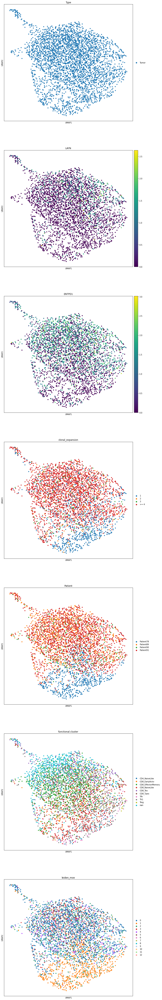

In [185]:
sc.pl.umap(adata_melonoma, color=['Type', 'LAYN', 'ENTPD1', 'clonal_expansion', 'Patient', 'functional.cluster', 'leiden_moe'], ncols=1, size=100)

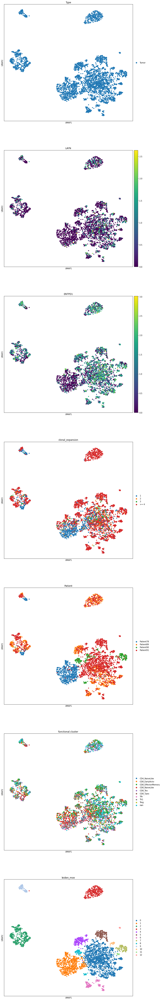

In [186]:
sc.pl.umap(adata_melonoma_moe, color=['Type', 'LAYN', 'ENTPD1', 'clonal_expansion', 'Patient', 'functional.cluster', 'leiden_moe'], ncols=1, size=100)

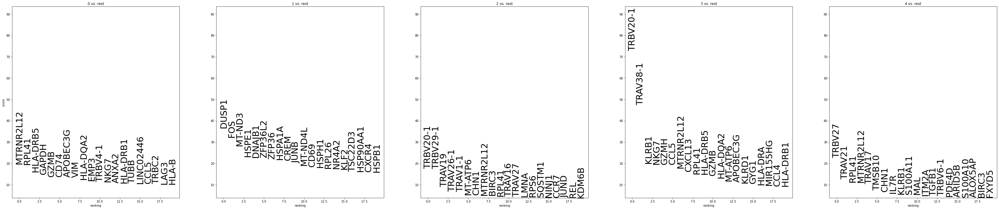

In [172]:
sc.tl.rank_genes_groups(adata_melonoma_moe, 'leiden_moe', n_genes=20)
sc.pl.rank_genes_groups(adata_melonoma_moe, groups=['0', '1', '2', '3', '4'], ncols=5, fontsize=30)

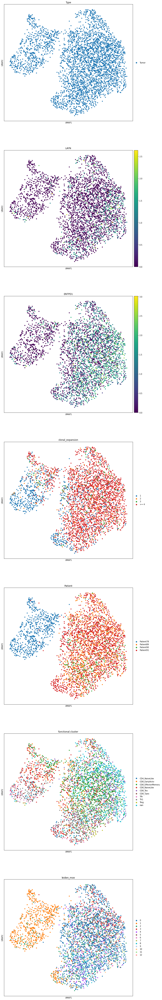

In [187]:
sc.pl.umap(adata_melonoma_rna, color=['Type', 'LAYN', 'ENTPD1', 'clonal_expansion', 'Patient', 'functional.cluster', 'leiden_moe'], ncols=1, size=100)

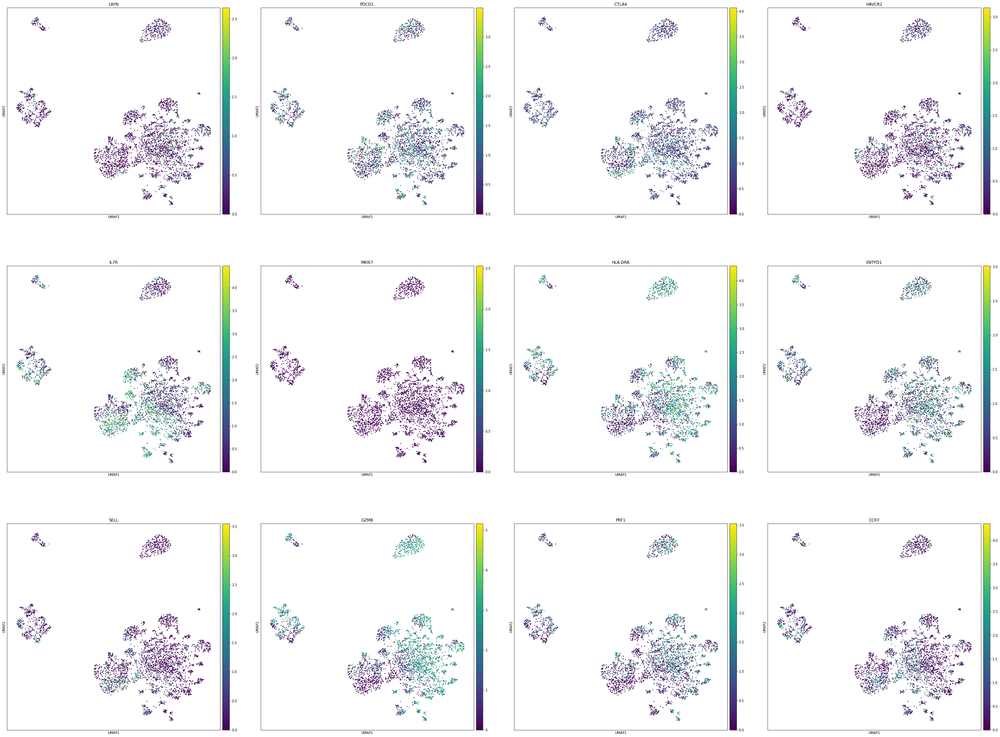

In [174]:
sc.pl.umap(adata_melonoma_moe, color=['LAYN', 'PDCD1', 'CTLA4', 'HAVCR2', 'IL7R', 'MKI67', 'HLA-DRA',
                                     'ENTPD1', 'SELL', 'GZMB', 'PRF1', 'CCR7'], ncols=4, size=30)

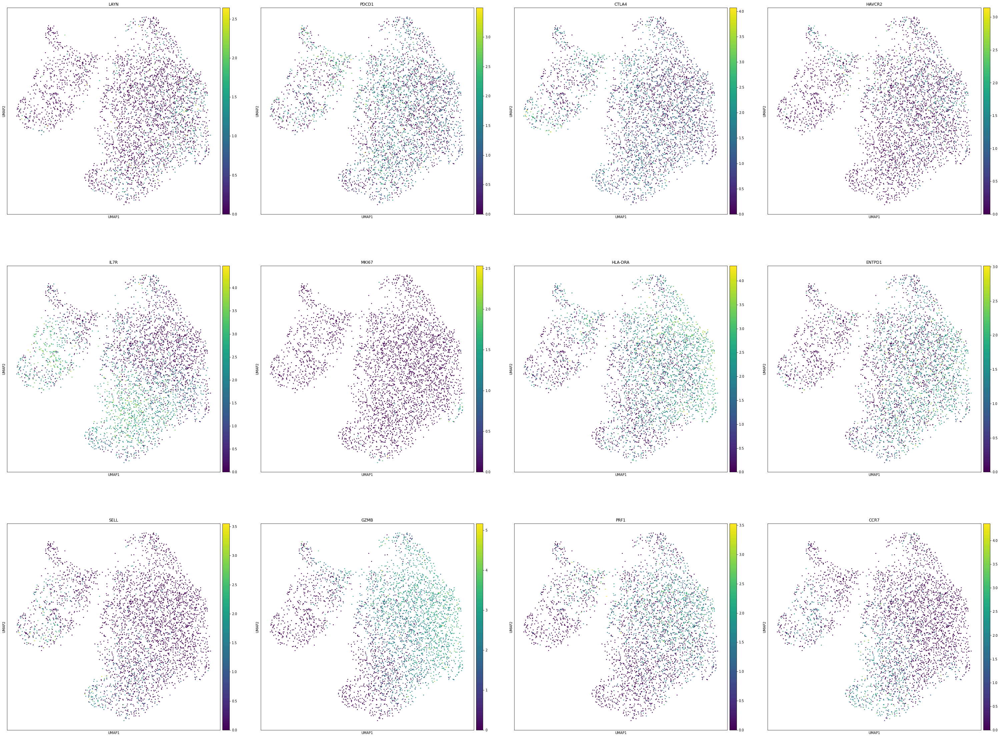

In [175]:
sc.pl.umap(adata_melonoma_rna, color=['LAYN', 'PDCD1', 'CTLA4', 'HAVCR2', 'IL7R', 'MKI67', 'HLA-DRA',
                                     'ENTPD1', 'SELL', 'GZMB', 'PRF1', 'CCR7'], ncols=4, size=30)

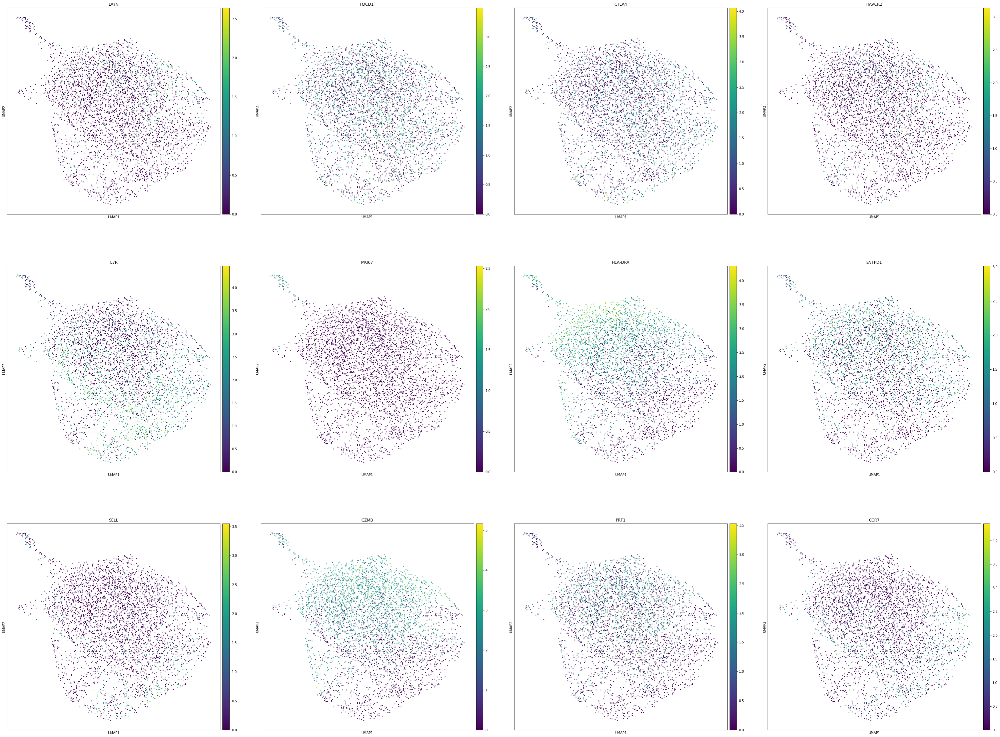

In [176]:
sc.pl.umap(adata_melonoma, color=['LAYN', 'PDCD1', 'CTLA4', 'HAVCR2', 'IL7R', 'MKI67', 'HLA-DRA',
                                     'ENTPD1', 'SELL', 'GZMB', 'PRF1', 'CCR7'], ncols=4, size=30)

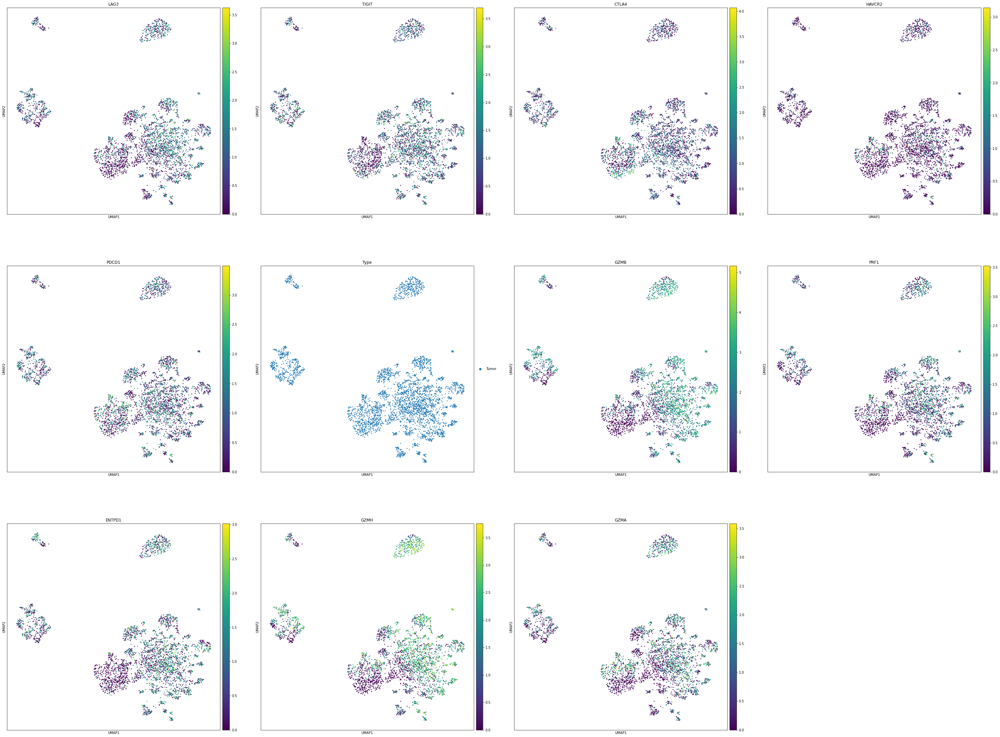

In [177]:
sc.pl.umap(adata_melonoma_moe, color=['LAG3', 'TIGIT', 'CTLA4', 'HAVCR2', 'PDCD1', 'Type',
                                      'GZMB', 'PRF1', 'ENTPD1', 'GZMH', 'GZMA'], ncols=4, size=30)

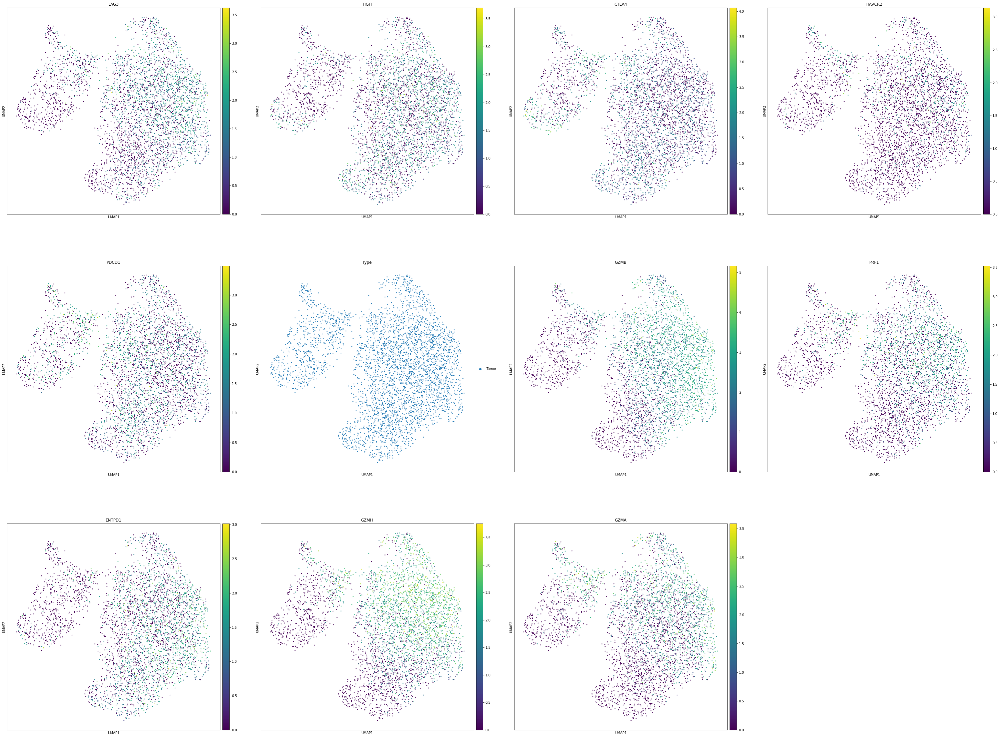

In [178]:
sc.pl.umap(adata_melonoma_rna, color=['LAG3', 'TIGIT', 'CTLA4', 'HAVCR2', 'PDCD1', 'Type', 
                                      'GZMB', 'PRF1', 'ENTPD1', 'GZMH', 'GZMA'], ncols=4, size=30)

In [179]:
adata_melonoma.obs['Patient'].value_counts()

Patient91    1857
Patient89     955
Patient78     679
Patient90     264
Name: Patient, dtype: int64

In [180]:
adata_melonoma.obs.groupby('Patient')['Type'].value_counts()

Patient    Type 
Patient78  Tumor     679
Patient89  Tumor     955
Patient90  Tumor     264
Patient91  Tumor    1857
Name: Type, dtype: int64

... storing 'Tissue+Type' as categorical
... storing 'clonotype' as categorical
... storing 'set' as categorical
... storing 'clonotype_261608' as categorical
... storing 'clonotype_261601' as categorical
... storing 'clonotype_261716' as categorical
... storing 'clonotype_261606' as categorical
... storing 'clonotype_261655' as categorical
... storing 'clonotype_261602' as categorical
... storing 'clonotype_261680' as categorical
... storing 'clonotype_261609' as categorical
... storing 'clonotype_261618' as categorical
... storing 'clonotype_188967' as categorical
... storing 'clonotype_261679' as categorical
... storing 'clonotype_261622' as categorical
... storing 'clonotype_261604' as categorical
... storing 'clonotype_261605' as categorical
... storing 'clonotype_261610' as categorical
... storing 'clonotype_261603' as categorical
... storing 'clonotype_261607' as categorical
... storing 'clonotype_261624' as categorical
... storing 'clonotype_261768' as categorical
... storing '

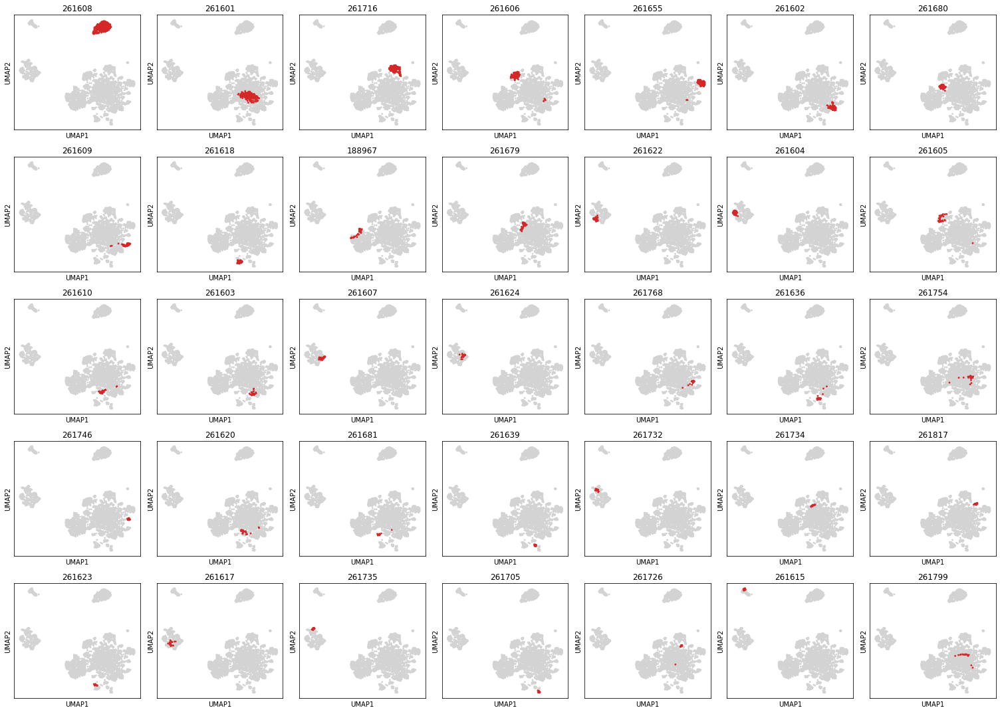

In [181]:
latent_melonoma.obs['clonotype'] = latent_melonoma.obs['clonotype'].astype(str)

n_cols = 7
n_rows = 5
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(21, 15))
axes = axes.reshape(-1)

top_35_clonotypes = list(latent_melonoma.obs['clonotype'].value_counts().head(35).index)

adata_tmp = latent_melonoma.copy()

for cluster in top_35_clonotypes:
    adata_tmp.obs[f'clonotype_{cluster}'] = (adata_tmp.obs['clonotype'] == cluster).astype(str)

for i, cluster in enumerate(top_35_clonotypes):
    row = i
    sc.pl.umap(adata_tmp, color=f'clonotype_{cluster}', groups='True', ax=axes[i], show=False, 
               palette=['tab:red']*50, title=cluster)
    axes[i].get_legend().remove()

fig.tight_layout()
plt.show()

In [182]:
latent_melonoma.obs['clonotype'].value_counts()

261608    286
261601    194
261716    152
261606    105
261655     88
         ... 
258103      1
257548      1
261925      1
262058      1
259579      1
Name: clonotype, Length: 1135, dtype: int64

In [183]:
adata_melonoma.obs['clonotype'] = adata_melonoma.obs['clonotype'].astype(str)
adata_melonoma[adata_melonoma.obs['clonotype'].isin(top_35_clonotypes)].obs['TRA+TRB'].value_counts()

CAFDNFNKFYF+CSARDGGQGTLEQYF          286
CASEPPSNTGKLIF+CASSQATLRGGDTQYF      194
CAVTTTDKLIF+CASSPDRGSNQPQHF          152
CAVDTGGFKTIF+CASGTGDRETQYF           105
CAGQRLETGGGADGLTF+CASSSYRDNQPQHF      88
CAVDAGGFKTIF+CASSLLDGNTEAFF           74
CAVYPSGGYQKVTF+CASSQDDSGAGNTIYF       63
CATDTGGFKTIF+CASSLDLSGANVLTF          53
CALDTGGFKTIF+CASNRGDGNFPLHF           48
CAEIRDYGQNFVF+CASSLDQNYEQYF           44
CASPGAGSYQLTF+CASSPRVASVETQYF         43
CALRKETGGGADGLTF+CSAQPREGYGYTF        42
CAVPFSGGYNKLIF+CSVDLRDRGTTDTQYF       39
CAVDTGGFKTIF+CASSPSLAGNEKLFF          36
CATGGTGFQKLVF+CASGTGDRETQYF           36
CAVDTGGFKTIF+CASSLADGSGGYTF           34
CIVKNAGNMLTF+CSADDRVGYEQYF            31
CALSVQGFQGAQKLVF+CSADDRVGYEQYF        30
CAVDTGGFKTIF+CASSVSDGNSPLHF           26
CATAALPSGGSYIPTF+CASSLPSAGANNEQFF     26
CAARGTSYDKVIF+CATSSLGDWTYNEQFF        25
CAVERWRDDKIIF+CASSYGGKNTEAFF          24
CAVDTGGFKTIF+CASSRADGEKLFF            24
CALSPEGFGNVLHC+CASSQGASASYNEQFF       22
CAGLRGSNYKLTF+CS

In [62]:
adata_ovarian = adata_borch[adata_borch.obs['Cohort']=='CCR-20-4394'].copy()
ir.tl.clonal_expansion(adata_ovarian, target_col='clonotype', clip_at=4)
adata_ovarian.obs['triplet+'] = np.all(adata_ovarian[:, ['ENTPD1', 'ITGAE', 'PDCD1']].X.A, axis=1)
adata_ovarian.obs['triplet+'] = adata_ovarian.obs['triplet+'].astype(str)
print(len(adata_ovarian))

12650


In [88]:
model_moe = load_model(adata_ovarian, 10, 'moe')
latent_ovarian = model_moe.get_latent(adata_ovarian, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_ovarian)
sc.tl.umap(latent_ovarian, spread=1)
#sc.tl.leiden(latent_melonoma, resolution=0.2, key_added='leiden_moe')
adata_ovarian_moe = adata_ovarian.copy()
adata_ovarian_moe.obsm['X_umap'] = latent_ovarian.obsm['X_umap'].copy()
#adata_melonoma_moe.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

In [64]:
model_rna = load_model(adata_ovarian, 10, 'rna')
latent_ovarian_rna = model_rna.get_latent(adata_ovarian, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_ovarian_rna)
sc.tl.umap(latent_ovarian_rna)
adata_ovarian_rna = adata_ovarian.copy()
adata_ovarian_rna.obsm['X_umap'] = latent_ovarian_rna.obsm['X_umap'].copy()
#adata_melonoma_rna.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

In [65]:
sc.pp.neighbors(adata_ovarian)
sc.tl.umap(adata_ovarian)
#adata_ovarian.obs['leiden_moe'] = latent_melonoma.obs['leiden_moe']

... storing 'Tissue+Type' as categorical
... storing 'set' as categorical
... storing 'clonal_expansion' as categorical
... storing 'triplet+' as categorical


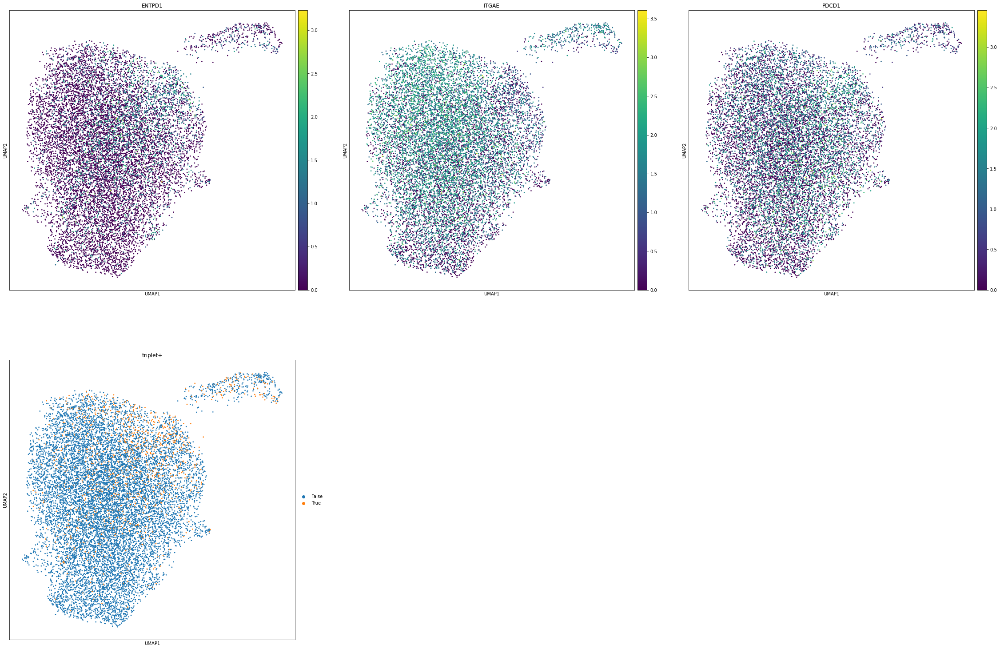

In [66]:
sc.pl.umap(adata_ovarian, color=['ENTPD1', 'ITGAE', 'PDCD1', 'triplet+'], ncols=3, size=30)

... storing 'Tissue+Type' as categorical
... storing 'set' as categorical
... storing 'clonal_expansion' as categorical
... storing 'triplet+' as categorical


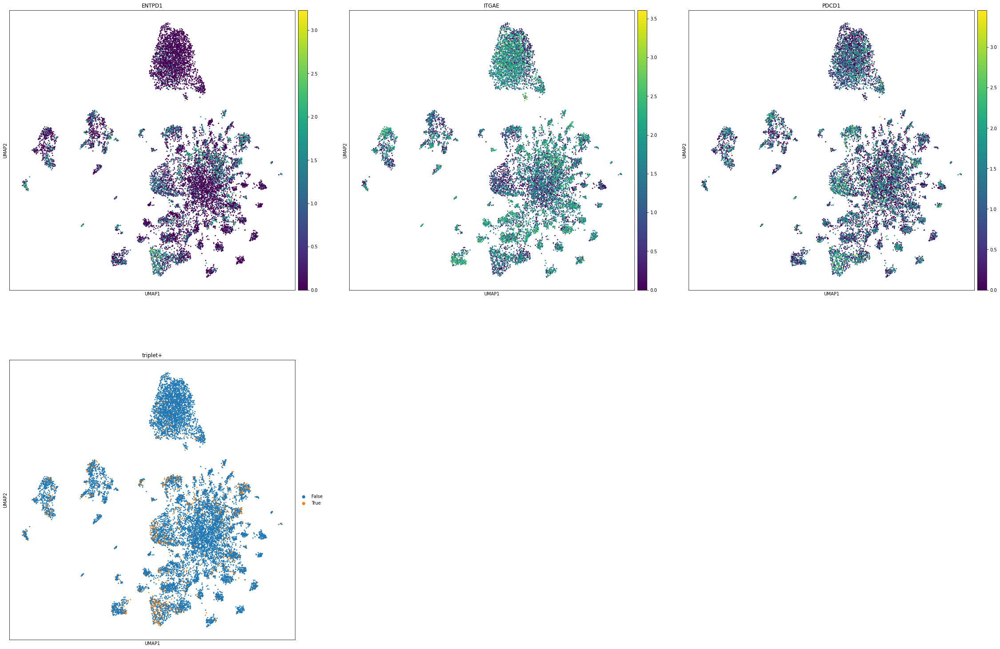

In [67]:
sc.pl.umap(adata_ovarian_moe, color=['ENTPD1', 'ITGAE', 'PDCD1', 'triplet+'], ncols=3, size=30)

... storing 'Tissue+Type' as categorical
... storing 'set' as categorical
... storing 'clonal_expansion' as categorical
... storing 'triplet+' as categorical


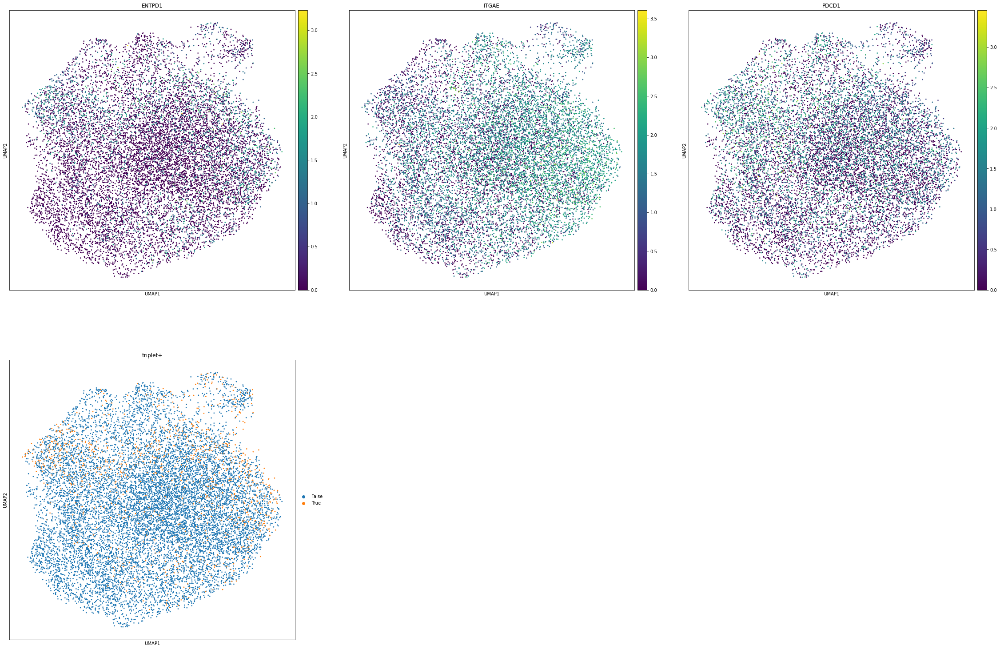

In [68]:
sc.pl.umap(adata_ovarian_rna, color=['ENTPD1', 'ITGAE', 'PDCD1', 'triplet+'], ncols=3, size=30)

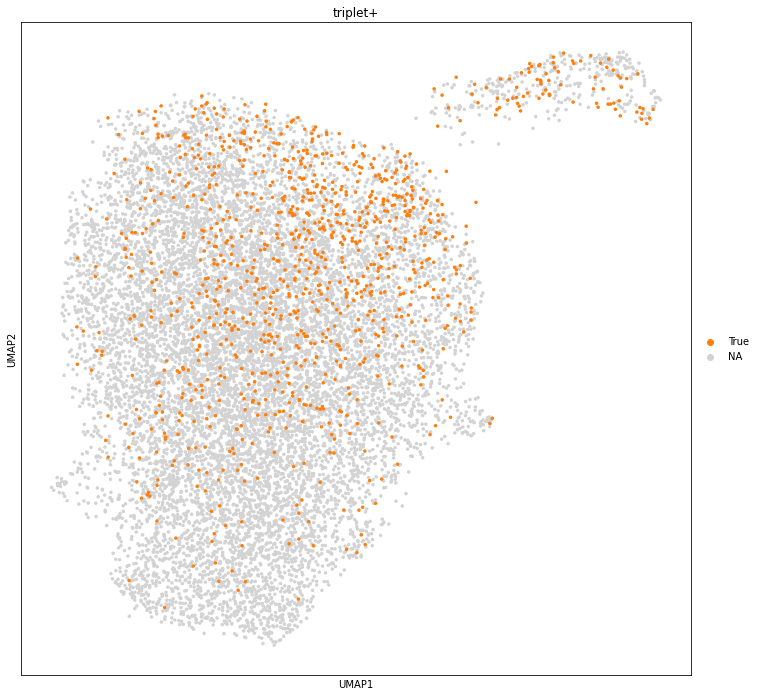

In [71]:
sc.pl.umap(adata_ovarian, color='triplet+', groups='True', ncols=3, size=50)

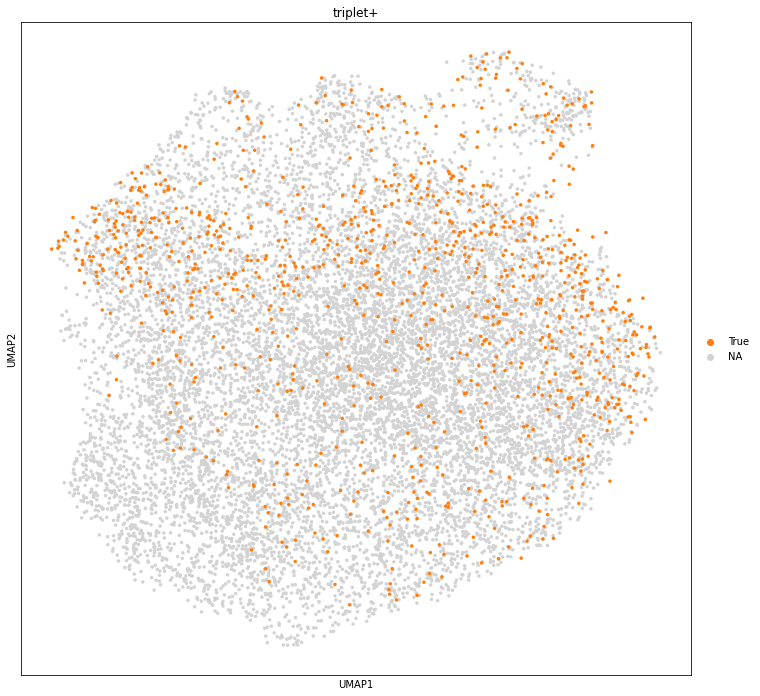

In [72]:
sc.pl.umap(adata_ovarian_rna, color='triplet+', groups='True', ncols=3, size=50)

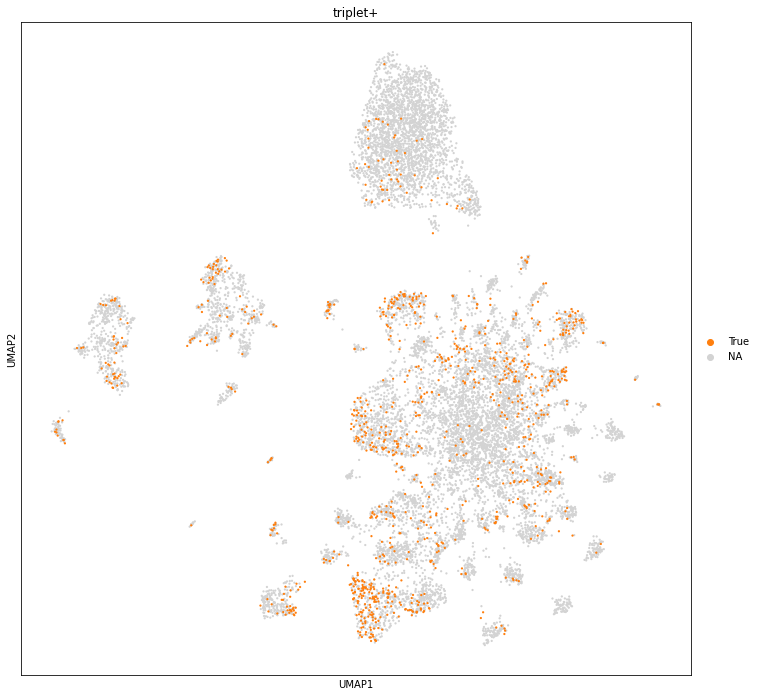

In [103]:
sc.pl.umap(adata_ovarian_moe, color='triplet+', groups='True', ncols=3, size=20)

... storing 'clonotype' as categorical
... storing 'clonotype_263122' as categorical
... storing 'clonotype_263541' as categorical
... storing 'clonotype_263525' as categorical
... storing 'clonotype_263542' as categorical
... storing 'clonotype_262454' as categorical
... storing 'clonotype_261759' as categorical
... storing 'clonotype_263524' as categorical
... storing 'clonotype_263070' as categorical
... storing 'clonotype_261716' as categorical
... storing 'clonotype_263094' as categorical
... storing 'clonotype_263084' as categorical
... storing 'clonotype_263526' as categorical
... storing 'clonotype_263523' as categorical
... storing 'clonotype_263075' as categorical
... storing 'clonotype_262467' as categorical
... storing 'clonotype_263074' as categorical
... storing 'clonotype_263071' as categorical
... storing 'clonotype_263069' as categorical
... storing 'clonotype_263076' as categorical
... storing 'clonotype_263085' as categorical
... storing 'clonotype_263093' as categor

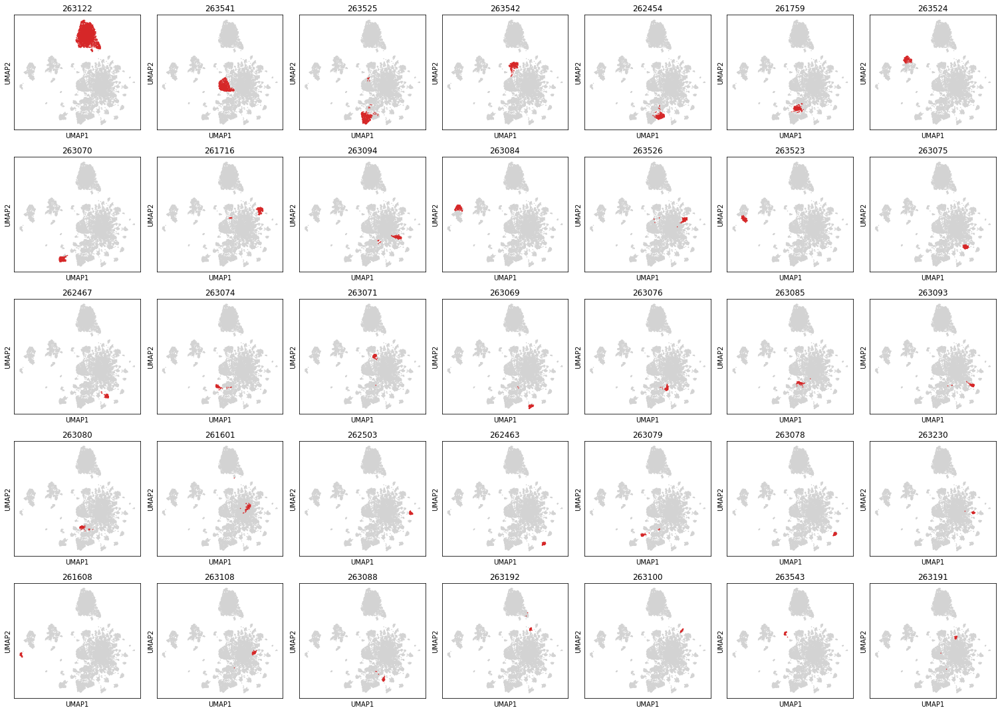

In [74]:
adata_ovarian_moe.obs['clonotype'] = adata_ovarian_moe.obs['clonotype'].astype(str)

n_cols = 7
n_rows = 5
fig, axes = plt.subplots(ncols=n_cols, nrows=n_rows, figsize=(21, 15))
axes = axes.reshape(-1)

top_35_clonotypes = list(adata_ovarian_moe.obs['clonotype'].value_counts().head(35).index)

adata_tmp = adata_ovarian_moe.copy()

for cluster in top_35_clonotypes:
    adata_tmp.obs[f'clonotype_{cluster}'] = (adata_tmp.obs['clonotype'] == cluster).astype(str)

for i, cluster in enumerate(top_35_clonotypes):
    row = i
    sc.pl.umap(adata_tmp, color=f'clonotype_{cluster}', groups='True', ax=axes[i], show=False, 
               palette=['tab:red']*50, title=cluster)
    axes[i].get_legend().remove()

fig.tight_layout()
plt.show()

In [77]:
adata_ovarian[adata_ovarian.obs['clonotype'].isin([263525, 262454])].obs['TRA+TRB'].value_counts()

CAVDTGGFKTIF+CASSTSDGNYGYTF    452
CAVDTGGFKTIF+CASSSGDGNYGYTF    250
Name: TRA+TRB, dtype: int64

In [78]:
adata_ovarian[adata_ovarian.obs['clonotype'].isin([263084, 263523])].obs['TRA+TRB'].value_counts()

CVVRGQNFVF+CASSLQGYEQYF            178
CAVSASYNNNDMRF+CASSQAGQGIFYGYTF    120
Name: TRA+TRB, dtype: int64

In [104]:
adata_breast = adata_borch[adata_borch.obs['Cohort']=='GSE114724'].copy()
ir.tl.clonal_expansion(adata_breast, target_col='clonotype', clip_at=4)
print(len(adata_breast))

5165


In [105]:
model_moe = load_model(adata_breast, 10, 'moe')
latent_breast = model_moe.get_latent(adata_breast, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_breast)
sc.tl.umap(latent_breast)
sc.tl.leiden(latent_breast, resolution=0.2, key_added='leiden_moe')
adata_breast_moe = adata_breast.copy()
adata_breast_moe.obsm['X_umap'] = latent_breast.obsm['X_umap'].copy()
adata_breast_moe.obs['leiden_moe'] = latent_breast.obs['leiden_moe']

In [106]:
model_rna = load_model(adata_breast, 10, 'rna')
latent_breast_rna = model_rna.get_latent(adata_breast, metadata=metadata, return_mean=True)
sc.pp.neighbors(latent_breast_rna)
sc.tl.umap(latent_breast_rna)
adata_breast_rna = adata_breast.copy()
adata_breast_rna.obsm['X_umap'] = latent_breast_rna.obsm['X_umap'].copy()
adata_breast_rna.obs['leiden_moe'] = latent_breast.obs['leiden_moe']

In [107]:
sc.pp.neighbors(adata_breast)
sc.tl.umap(adata_breast)
adata_breast.obs['leiden_moe'] = latent_breast.obs['leiden_moe']

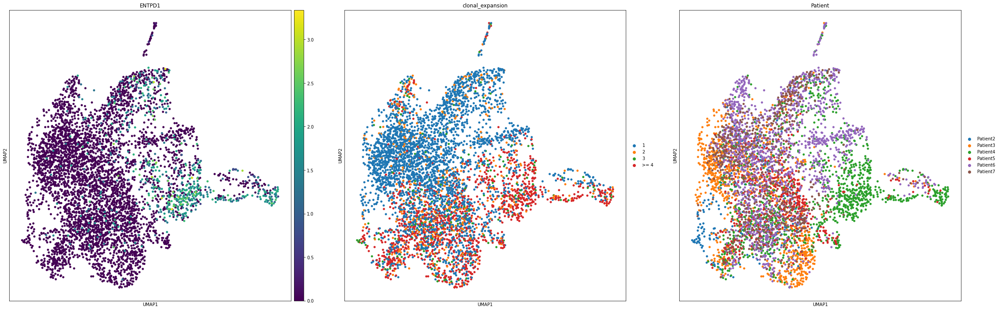

In [121]:
sc.pl.umap(adata_breast, color=['ENTPD1', 'clonal_expansion', 'Patient',], ncols=3, size=100)

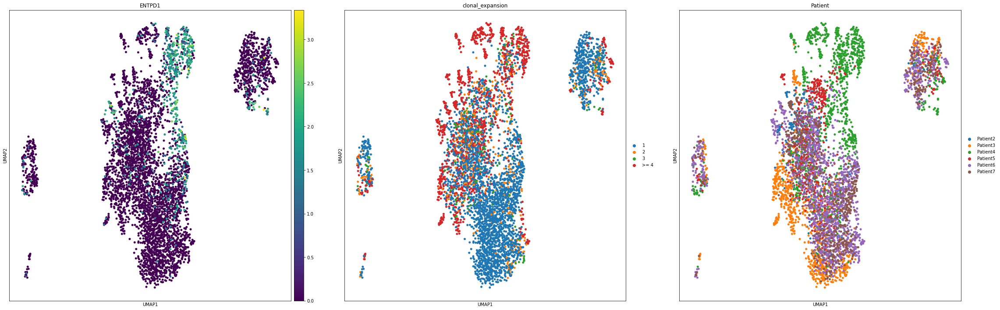

In [120]:
sc.pl.umap(adata_breast_moe, color=['ENTPD1', 'clonal_expansion', 'Patient'], ncols=3, size=100)

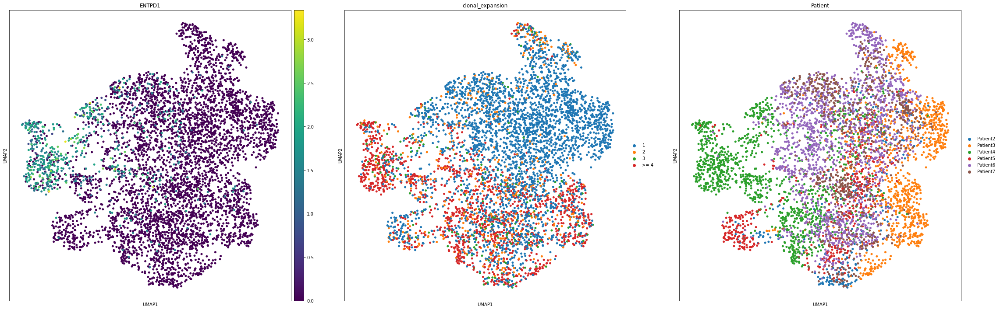

In [119]:
sc.pl.umap(adata_breast_rna, color=['ENTPD1', 'clonal_expansion', 'Patient'], ncols=3, size=100)